#Stock Price Prediction using LSTMs

The dataset contains following features:

1. Ticker/symbol: Symbol for a particular stock.
2. Open: Contains the price the stock opened with on a particular day.
3. Close: Contains the price the stock closed on, on a particular day.
4. High: Contains the highest value reached on a particular day.
5. Low: Contains the lowest values reached on a particular day.
6. Volume: Contains the number of shares of a security traded between its daily open and close
7. Date

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px
import seaborn as sns
import pandas as pd
from pandas import datetime
import math, time
import itertools
from sklearn import preprocessing
import datetime
from operator import itemgetter
from sklearn.metrics import mean_squared_error
from math import sqrt

import os
import io

In [2]:
#loading the dataset using google.colab
from google.colab import files
stockPricesData = files.upload()

prices_df = pd.read_csv(io.BytesIO(stockPricesData['stock_prices.csv']))

Saving stock_prices.csv to stock_prices (1).csv


In [4]:
prices_df.info()
prices_df.head(6)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 851264 entries, 0 to 851263
Data columns (total 7 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   date    851264 non-null  object 
 1   symbol  851264 non-null  object 
 2   open    851264 non-null  float64
 3   close   851264 non-null  float64
 4   low     851264 non-null  float64
 5   high    851264 non-null  float64
 6   volume  851264 non-null  float64
dtypes: float64(5), object(2)
memory usage: 45.5+ MB


,date,symbol,open,close,low,high,volume
0,2016-01-05,WLTW,123.430000,125.839996,122.309998,126.250000,2163600.0
1,2016-01-06,WLTW,125.239998,119.980003,119.940002,125.540001,2386400.0
2,2016-01-07,WLTW,116.379997,114.949997,114.930000,119.739998,2489500.0
3,2016-01-08,WLTW,115.480003,116.620003,113.500000,117.440002,2006300.0
4,2016-01-11,WLTW,117.010002,114.970001,114.089996,117.330002,1408600.0
5,2016-01-12,WLTW,115.510002,115.550003,114.500000,116.059998,1098000.0


#Preparaing the data

In [5]:
#making a list of symbols
tikr = list(set(prices_df.symbol))
len(tikr)

501

In [6]:
tikr[:10]

['L', 'LVLT', 'TGT', 'GPC', 'EXR', 'ALLE', 'GOOG', 'MAA', 'CXO', 'KMX']

In [7]:
prices_df.describe()

,open,close,low,high,volume
count,851264.000000,851264.000000,851264.000000,851264.000000,8.512640e+05
mean,64.993618,65.011913,64.336541,65.639748,5.415113e+06
std,75.203893,75.201216,74.459518,75.906861,1.249468e+07
min,1.660000,1.590000,1.500000,1.810000,0.000000e+00
25%,31.270000,31.292776,30.940001,31.620001,1.221500e+06
50%,48.459999,48.480000,47.970001,48.959999,2.476250e+06
75%,75.120003,75.139999,74.400002,75.849998,5.222500e+06
max,1584.439941,1578.130005,1549.939941,1600.930054,8.596434e+08


In [8]:
#extracting the Google stock as a example
goog_df = prices_df[prices_df.symbol == 'GOOG']
goog_df.drop(['symbol'],1,inplace=True)
goog_df.head()

/usr/local/lib/python3.6/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,open,close,low,high,volume
439,2010-01-04,312.304948,312.205308,310.955001,313.580158,3927000.0
907,2010-01-05,312.419511,310.830459,309.610028,312.748278,6031900.0
1375,2010-01-06,311.761979,302.994813,302.048370,311.761979,7987100.0
1843,2010-01-07,303.562685,295.941242,295.218951,303.861575,12876600.0
2311,2010-01-08,294.895159,299.886470,293.455551,300.499172,9483900.0


In [9]:
goog_df.shape

(1762, 6)

#Data Analysis

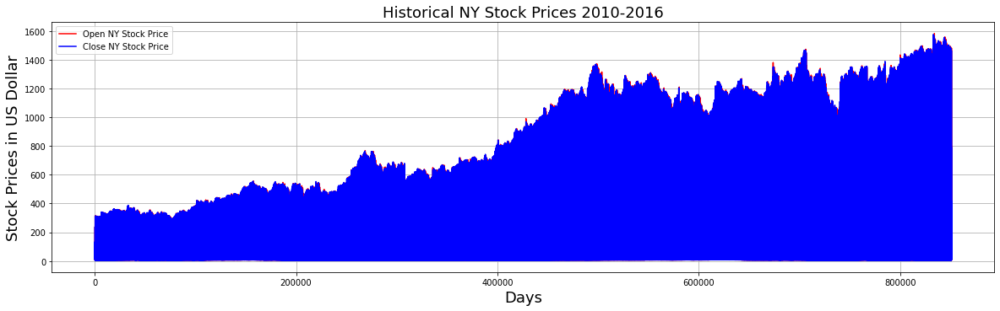

In [26]:
#plotting general open and close from year 2010 to 2016
plt.figure(figsize = (20, 12))
x = np.arange(0, prices_df.shape[0], 1)
plt.subplot(2,1,1)
plt.plot(x, prices_df.open.values, color = "red", label = "Open NY Stock Price")
plt.plot(x, prices_df.close.values, color = "blue", label = "Close NY Stock Price")
plt.title("Historical NY Stock Prices 2010-2016", fontsize = 18)
plt.xlabel("Days", fontsize = 18)
plt.ylabel("Stock Prices in US Dollar", fontsize = 18)
plt.legend(loc = "best")
plt.grid(which = "major", axis = "both")

It can be seen that over time the NYSE's opening value went higher. We can see a significant drop in the year 2016. This points to the stock crash in 2016 that happened in June.

Overall we see that the stock price has risen over time.

In [11]:
fig = px.line(prices_df, x="date", y="volume", title='NY Stock traded over the years')
fig.show()

The graph above shows the overall volume of the NYSE stocks. We see that the highest point in trading the stocks was around mid of 2011.

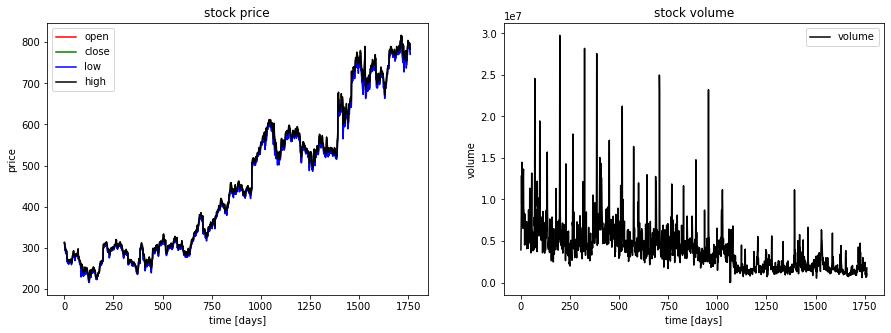

In [12]:
#plotting for Google
plt.figure(figsize=(15, 5));
plt.subplot(1,2,1);
plt.plot(prices_df[prices_df.symbol == 'GOOG'].open.values, color='red', label='open')
plt.plot(prices_df[prices_df.symbol == 'GOOG'].close.values, color='green', label='close')
plt.plot(prices_df[prices_df.symbol == 'GOOG'].low.values, color='blue', label='low')
plt.plot(prices_df[prices_df.symbol == 'GOOG'].high.values, color='black', label='high')
plt.title('stock price')
plt.xlabel('time [days]')
plt.ylabel('price')
plt.legend(loc='best')

plt.subplot(1,2,2);
plt.plot(prices_df[prices_df.symbol == 'GOOG'].volume.values, color='black', label='volume')
plt.title('stock volume')
plt.xlabel('time [days]')
plt.ylabel('volume')
plt.legend(loc='best');

The graphs above are plotted for Google stock specifially. The first graph shows the open, close, low and high values over the years. The second graph shows the number of stocks traded. 

We can deduce that the stock trading for Google's stock decreased, while the stock price went up.

In [13]:
fig = make_subplots(rows=1, cols=2, column_widths=[0.6, 0.4])
fig.add_trace(go.Scatter(x= goog_df.date, y=goog_df.open.diff(), name='l1'),row=1, col=1)
fig.add_trace(go.Histogram(x=goog_df['open'].diff(), name='h1', histnorm='probability density'), row=1, col=2)
fig.update_layout( height=550, width=1130, title_text="Consecutive difference between opening stock price of Google shares")
fig.update_xaxes(title_text="Time", row=1, col=1);   fig.update_xaxes(title_text="Value", row=1, col=2)
fig.update_yaxes(title_text="Value", row=1, col=1);   fig.update_yaxes(title_text="Prob. Density", row=1, col=2)
fig.show()

The graph on the left shows the differnce of the opening values of Google stock over the period of six years. Graph on the right shows the distribution of the opening difference.

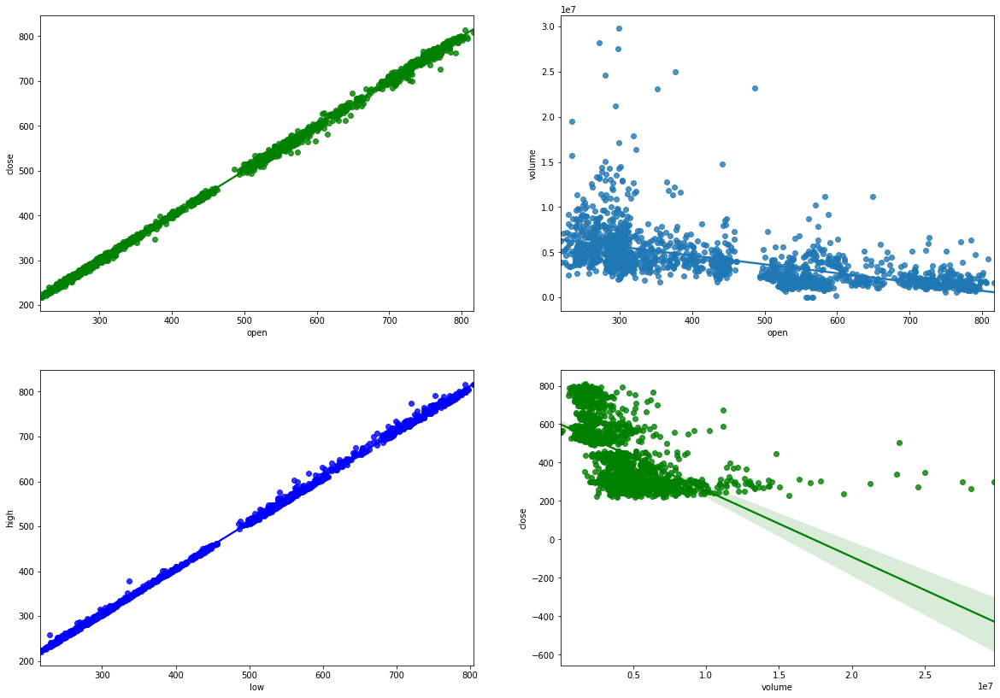

In [14]:
f, axes= plt.subplots(2,2, figsize=(20,14))
sns.regplot(x=goog_df.open, y=goog_df.close, color="g", ax=axes[0][0]) #relationship between open and close
sns.regplot(x=goog_df.open, y=goog_df.volume, ax=axes[0][1]) #relationship between open and volume
sns.regplot(x=goog_df.low, y=goog_df.high, color="b", ax=axes[1][0]) #relationship between low and high
sns.regplot(x=goog_df.volume, y=goog_df.close, color="g", ax=axes[1][1]) #relationship between volume and close

From these regression plots we get the relationship between our four main features.

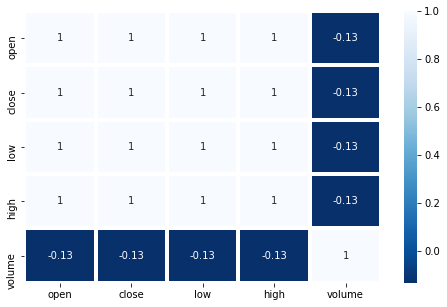

In [15]:
corr= prices_df.corr()
plt.figure(figsize=(8,5))
sns.heatmap(corr, annot=True, cmap="Blues_r",linewidth = 3, linecolor = "white")

We see from the heatmap that our four features are highly correlated.

In [16]:
fig = px.line(goog_df, x="date", y="volume", title='Google Stock traded over the years')
fig.show()

the graph above shows the trading trends of the Google stock. We see that over time the Google stock trading decreased.

In [17]:
fig = px.line(goog_df, x="date", y="close", title='Google Stock closing value of the day over the years')
fig.show()

The graph shows us that over time Google stock's closing value went higher.

In [18]:
fig = px.line(goog_df, x="date", y="open", title='Google Stock opening value of the day over the years')
fig.show()

We see the same trend in the opening price.

Analysis of top three indices of S&P 500, according to https://www.spglobal.com/spdji/en/indices/equity/sp-500-top-50/#overview, last updated on 30th October 2020. The top three indices listed are:
1. Apple [AAPL]
2. Mircosoft [MSFT]
3. Amazon [AMZN]

In [19]:
#making a month column to compare monthly stock prices
import datetime

prices_df['month'] = pd.DatetimeIndex(prices_df['date']).month
prices_df.head(4)

,date,symbol,open,close,low,high,volume,month
0,2016-01-05,WLTW,123.430000,125.839996,122.309998,126.250000,2163600.0,1
1,2016-01-06,WLTW,125.239998,119.980003,119.940002,125.540001,2386400.0,1
2,2016-01-07,WLTW,116.379997,114.949997,114.930000,119.739998,2489500.0,1
3,2016-01-08,WLTW,115.480003,116.620003,113.500000,117.440002,2006300.0,1


In [20]:
#making a dataframe for only open and close values of the stocks
opcl_df = pd.DataFrame(prices_df['open'])
opcl_df = pd.DataFrame(prices_df, columns = ['open', 'close', 'symbol']) 
opcl_df.head(4)

,open,close,symbol
0,123.430000,125.839996,WLTW
1,125.239998,119.980003,WLTW
2,116.379997,114.949997,WLTW
3,115.480003,116.620003,WLTW


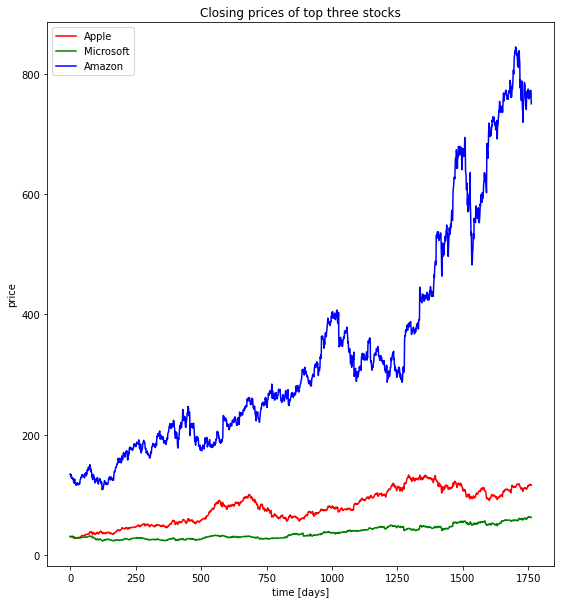

In [22]:
#plotting the monthly stock prices to the top three indices
plt.figure(figsize=(20, 10));
plt.subplot(1,2,1);
plt.plot(opcl_df[opcl_df.symbol == 'AAPL'].close.values, color='red', label='Apple')
plt.plot(opcl_df[opcl_df.symbol == 'MSFT'].close.values, color='green', label='Microsoft')
plt.plot(opcl_df[opcl_df.symbol == 'AMZN'].close.values, color='blue', label='Amazon')

plt.title('Closing prices of top three stocks')
plt.xlabel('time [days]')
plt.ylabel('price')
plt.legend(loc='best')

The plot above compares the closing price of the top three stocks, namely, Apple, Microsoft and Amazon. We conclude that Amazon has a higher values compared to the other two stocks.

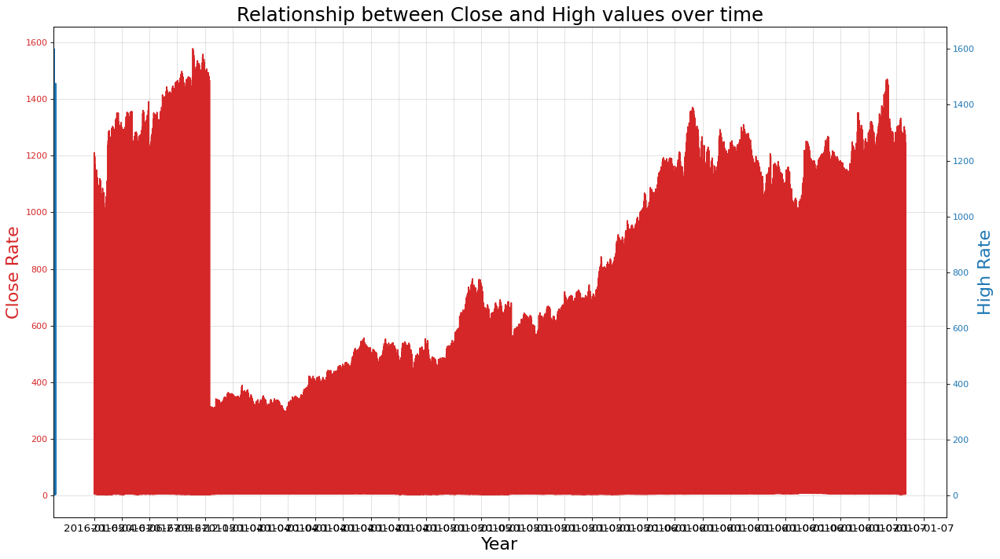

In [25]:
x = prices_df['date']
y1 = prices_df['close']
y2 = prices_df['high']

# Plot Line1 (Left Y Axis)
fig, ax1 = plt.subplots(1,1,figsize=(16,9), dpi= 80)
ax1.plot(x, y1, color='tab:red')

# Plot Line2 (Right Y Axis)
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
ax2.plot(x, y2, color='tab:blue')

# ax1 (left Y axis)
ax1.set_xlabel('Year', fontsize=20)
ax1.tick_params(axis='x', rotation=0, labelsize=12)
ax1.set_ylabel('Close Rate', color='tab:red', fontsize=20)
ax1.tick_params(axis='y', rotation=0, labelcolor='tab:red' )
ax1.grid(alpha=.4)

# ax2 (right Y axis)
ax2.set_ylabel("High Rate", color='tab:blue', fontsize=20)
ax2.tick_params(axis='y', labelcolor='tab:blue')
ax2.set_xticks(np.arange(0, len(x), 60))
ax2.set_xticklabels(x[::60], rotation=90, fontdict={'fontsize':10})
ax2.set_title("Relationship between Close and High values over time", fontsize=22)
fig.tight_layout()
plt.show()

The plot shows the relationship between the close and high value over time.